In [1]:
import requests
from bs4 import BeautifulSoup
import json
import os
from selenium import webdriver
from selenium.webdriver.chrome.service import Service
from webdriver_manager.chrome import ChromeDriverManager

import pandas as pd
import geopandas as gpd
import numpy as np
import time
import datetime
import plotly
import plotly_express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt

# tests
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose

# modeling
from statsmodels.tsa.arima.model import ARIMA

# evaluation
from scipy import stats
import statsmodels.api as sm
import sklearn.metrics as metrics

# other tools
import warnings
from tqdm import tqdm

C:\Users\Mikhail\AppData\Roaming\Python\Python39\site-packages\statsmodels\compat\pandas.py:61: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import Int64Index as NumericIndex


# Getting data

## Var 1

### reading data about tables and writing to a file

In [2]:
url = "https://dtp-stat.ru/opendata"
requests.get(url).status_code

200

In [3]:
soup = BeautifulSoup(requests.get(url).content.decode("UTF-8"))

In [4]:
files_data = []
for row in soup.find_all("tr"):
    files_data.append([])
    for col_num, cell in enumerate(row.find_all("td")):
        if col_num != len(row.find_all("td"))-1:
            files_data[-1].append(cell.get_text())
        else:
            files_data[-1].append(cell.find("a").get("href"))
            
with open(file="dtp-stats.csv", mode="w", encoding="utf-8") as file:
    for row in files_data:
        file.write(",".join(row))
        file.write("\n")

In [5]:
with open(file="dtp-stats.csv", mode="r", encoding="utf-8") as file:
    files_data = file.readlines()
    files_data = list(map(lambda x: x.strip().split(","), files_data))

## Var 2

In [6]:
pd.read_html(url)[0].head().style.set_properties(**{'background-color': 'red'}, 
                                        axis=0, 
                                        subset=pd.IndexSlice[:, 3])

,0,1,2,3
0,Алтайский край,январь 2015 - октябрь 2022,47.18 mb,Скачать .geojson
1,Амурская область,январь 2015 - октябрь 2022,19.53 mb,Скачать .geojson
2,Архангельская область,январь 2015 - октябрь 2022,22.05 mb,Скачать .geojson
3,Астраханская область,январь 2015 - октябрь 2022,20.81 mb,Скачать .geojson
4,Белгородская область,январь 2015 - октябрь 2022,19.56 mb,Скачать .geojson


Far not always pandas solves a problem. All links must be parsed manually

### Taking dataset of Moscow

In [7]:
moscow_url = list(filter(lambda x: x[0]=="Москва", files_data))[0][-1]
moscow_url

'https://cms.dtp-stat.ru/media/opendata/moskva.geojson'

In [8]:
driver = webdriver.Chrome(service=Service(ChromeDriverManager().install()))
driver.get(moscow_url)
time.sleep(20)
driver.quit()
time.sleep(20)

In [9]:
path_of_download = "C:/Users/Mikhail/Downloads/"
file_name = moscow_url.split("/")[-1]

In [10]:
data = gpd.read_file(path_of_download+file_name)

In [11]:
data['lat'] = list(map(lambda x: x['lat'], data.point))
data['long'] = list(map(lambda x: x['long'], data.point))

In [12]:
data.head()

,id,light,point,region,scheme,address,category,datetime,severity,dead_count,injured_count,parent_region,participants_count,geometry,lat,long
0,1578559,"В темное время суток, освещение включено","{'lat': 55.812, 'long': 37.637}",Останкинский,070,"г Москва, пр-кт Мира, 81",Наезд на стоящее ТС,2016-01-11T21:10:00,Легкий,0,1,Москва,3,POINT (37.63700 55.81200),55.812000,37.637000
1,1543760,Светлое время суток,"{'lat': 55.659167, 'long': 37.595}",Зюзино,740,"г Москва, ул Одесская, 17",Наезд на пешехода,2015-09-08T14:00:00,Тяжёлый,0,1,Москва,2,POINT (37.59500 55.65917),55.659167,37.595000
2,1576409,"В темное время суток, освещение включено","{'lat': 55.6544, 'long': 37.4414}",Тропарево-Никулино,070,"г Москва, Московская кольцевая автомобильная д...",Столкновение,2018-03-16T01:00:00,Тяжёлый,0,1,Москва,2,POINT (37.44140 55.65440),55.654400,37.441400
3,1570759,"В темное время суток, освещение включено","{'lat': 55.708141, 'long': 37.613598}",Даниловский,720,"г Москва, ул Рощинская 3-я, 3 СТР4",Наезд на пешехода,2017-10-24T19:15:00,Легкий,0,1,Москва,2,POINT (37.61360 55.70814),55.708141,37.613598
4,2523560,Светлое время суток,"{'lat': 55.767442, 'long': 37.798183}",Измайлово,920,"г Москва, ш Энтузиастов, 88 стр. 6",Наезд на стоящее ТС,2020-12-17T08:30:00,Легкий,0,1,Москва,3,POINT (37.79818 55.76744),55.767442,37.798183


In [13]:
data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 69833 entries, 0 to 69832
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   id                  69833 non-null  int64   
 1   light               69833 non-null  object  
 2   point               69833 non-null  object  
 3   region              69833 non-null  object  
 4   scheme              67660 non-null  object  
 5   address             65265 non-null  object  
 6   category            69833 non-null  object  
 7   datetime            69833 non-null  object  
 8   severity            69833 non-null  object  
 9   dead_count          69833 non-null  int64   
 10  injured_count       69833 non-null  int64   
 11  parent_region       69833 non-null  object  
 12  participants_count  69833 non-null  int64   
 13  geometry            69750 non-null  geometry
 14  lat                 69750 non-null  float64 
 15  long                69750 no

In [14]:
# Сброс ограничений на количество выводимых рядов
pd.set_option('display.max_rows', None)
 
# Сброс ограничений на число столбцов
pd.set_option('display.max_columns', None)
 
# Сброс ограничений на количество символов в записи
pd.set_option('display.max_colwidth', None)

In [15]:
data.drop(list(data.loc[(data.lat>56.0117)|\
                   (data.lat<55.2)|\
                   (data.long<37)|\
                   (data.long>38)].index), axis=0, inplace=True)
data.dropna(inplace=True)
data.shape

(62196, 16)

In [16]:
data.datetime = data.datetime.apply(lambda x: datetime.datetime.strptime(x, "%Y-%m-%dT%H:%M:%S"))

# Data exploration

In [17]:
temp_data = data.groupby("region").count().sort_values("participants_count")
fig = px.bar(data_frame=temp_data,
            x=temp_data.index, 
            y=["participants_count"],
            title="Participants of car accidents in Moscow by region",
            template="presentation",
            labels={"region":""})
fig.update_layout(xaxis={"tickfont":dict(size=7)},
                 showlegend=False)

In [18]:
temp_data = data.groupby("region").sum().sort_values("participants_count")
fig = px.bar(data_frame=temp_data,
            x=temp_data.index, 
            y=["participants_count", "dead_count", "injured_count"],
            title="Participants of car accidents in Moscow by region",
            template="presentation",
            labels={"region":""})
fig.update_layout(xaxis={"tickfont":dict(size=7)},
                 legend={"x":0, "y":.8})

In [19]:
temp_data = data.groupby("category").agg({"participants_count":"count"}).participants_count
if temp_data.loc[temp_data<70].sum():
            temp_data['Прочее'] = temp_data.loc[temp_data<70].sum()
            temp_data.drop(temp_data.loc[(temp_data<70)&(temp_data.index!='Rest')].index, inplace=True)          
temp_data = pd.DataFrame(temp_data.sort_values())

px.pie(temp_data, 
       names=temp_data.index,
       values=temp_data.participants_count,
       title="Types of car accidents in Moscow",
       template="presentation",)

In [20]:
temp_data = data.groupby([pd.Grouper(key='datetime', axis=0, freq='D'),pd.Grouper(key='datetime', axis=0, freq='H')]).count()
temp_data.index.names = ["day", "hour"]
temp_data.reset_index(inplace=True)
temp_data.hour = temp_data.hour.apply(lambda x: x.time().hour)
temp_data = pd.pivot_table(temp_data, values=["participants_count"], index=["hour"], columns=["day"])
temp_data.columns = [i[1] for i in temp_data.columns]
temp_data.fillna(0, inplace=True)
temp_data.sum().mean()

21.73925200978679

In [21]:
fig = px.line(temp_data.mean(axis=1), title="Number of car accidents in Moscow by hour (mean value)",
        template="presentation")
fig.update_layout(showlegend=False)

In [22]:
px.density_mapbox(data_frame=data,
                  lat="lat",
                  lon="long",
                  z="participants_count",
                  title="Participants of car accidents in Moscow",
                  template="presentation",
                  mapbox_style="stamen-terrain",
                  radius=5,
                  hover_name="address",
                  hover_data=["injured_count", "dead_count"])

In [23]:
temp_data = data.groupby(pd.Grouper(key='datetime', axis=0, freq='M')).sum()
data_1 = temp_data.participants_count.copy()
print(temp_data.shape)
px.line(data_frame=temp_data,
        x=temp_data.index, 
        y=["participants_count", "dead_count", "injured_count"],
        title="Participants of car accidents in Moscow",
        template="presentation",)


(94, 6)


# ARIMA

In [24]:
data_1 = pd.DataFrame(data_1)
data_1["log_diff"] = np.log(data_1.participants_count.pct_change()+1)
data_1.dropna(inplace=True)
# data_1.loc[data_1.log_diff<-.7] = data_1.loc[data_1.log_diff>-.7].mean().to_numpy()
# data_1

In [25]:
y_real_train = data_1[:"2021-01-01"].participants_count
y_real_test = data_1["2021-01-01":].participants_count
y_log_train = data_1[:"2021-01-01"].log_diff
y_log_test = data_1["2021-01-01":].log_diff
X = pd.DataFrame(index=data_1.index, columns=["Corona"], data=np.zeros(len(data_1.index)))
X.loc[(X.index>"2020-03-31")&(X.index<"2020-10-31")] = 1
X_train = data_1[:"2021-01-01"].participants_count
X_test = data_1["2021-01-01":].participants_count
y_log_train.shape[0]+y_log_test.shape[0]==data_1.shape[0]

True

In [26]:
# y_real_train, y_real_test

In [27]:
def adf_test(timeseries):
    # Выполняем тест Дики-Фуллера:
    # Маленький p-value -- ряд стационарен    
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    dfoutput.name = timeseries.name
    return dfoutput

# cols = df.columns

results = pd.DataFrame(index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for i in [y_real_train, y_log_train]:
    results = pd.concat([results, adf_test(i)], axis=1)
    
results.transpose().round(3)

,Test Statistic,p-value,#Lags Used,Number of Observations Used,Critical Value (1%),Critical Value (5%),Critical Value (10%)
participants_count,-1.275,0.641,12.0,58.0,-3.548,-2.913,-2.594
log_diff,-6.566,0.000,10.0,60.0,-3.544,-2.911,-2.593


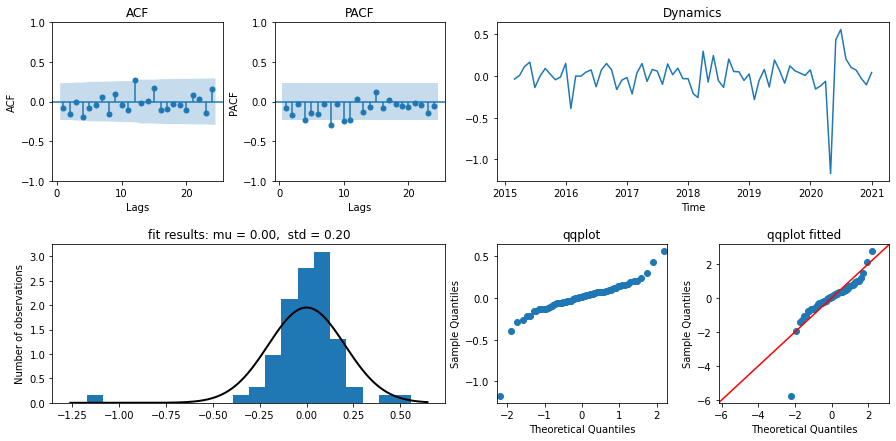

In [28]:
fig = plt.figure(figsize=(15, 7))
grid = (2, 4)
ax0 = plt.subplot2grid(grid, (0, 0), rowspan=1, colspan=1)
ax1 = plt.subplot2grid(grid, (0, 1), rowspan=1, colspan=1)
ax2 = plt.subplot2grid(grid, (0, 2), rowspan=1, colspan=2)
ax3 = plt.subplot2grid(grid, (1, 0), rowspan=1, colspan=2)
ax4 = plt.subplot2grid(grid, (1, 2), rowspan=1, colspan=1)
ax5 = plt.subplot2grid(grid, (1, 3), rowspan=1, colspan=1)

plt.subplots_adjust(wspace=0.3, hspace=0.4)

# Autocorrelation function
plot_acf(x=y_log_train, ax=ax0, lags = np.arange(1, 25))
# ax0.set_ylim(-0.15, 0.15)
ax0.set_title(f'''ACF''')
ax0.set_xlabel('Lags')
ax0.set_ylabel('ACF')

# Partial autocorrelation function
plot_pacf(x=y_log_train, ax=ax1, lags = np.arange(1, 25), method='ywm')
# ax1.set_ylim(-0.15, 0.15)
ax1.set_title(f'''PACF''')
ax1.set_xlabel('Lags')
ax1.set_ylabel('PACF')

# Plotting dynamics
ax2.plot(y_log_train)
ax2.set_title("Dynamics")
ax2.set_xlabel("Time")

# Fit a normal distribution to the data:
mu, std = stats.norm.fit(y_log_train)

# Plot the histogram.
ax3.hist(y_log_train, bins=20, density=True)
# ax0.set_xlim(-0.2, 0.2)

# Plot the PDF.
xmin, xmax = ax3.get_xlim()
x = np.linspace(xmin, xmax, 1000)
p = stats.norm.pdf(x, mu, std)
ax3.plot(x, p, 'k', linewidth=2)
title = f"fit results: mu = %.2f,  std = %.2f" % (mu, std)
ax3.set_title(title)
ax3.set_ylabel("Number of observations")

sm.qqplot(y_log_train, ax=ax4)
ax4.set_title("qqplot")
sm.qqplot(y_log_train, fit=True, line="45", ax=ax5)
ax5.set_title("qqplot fitted")

plt.show()

In [29]:
def auto_ariming(p, d, q, y_train, y_test=None):
    model_results = pd.DataFrame()
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        with tqdm(total=p * d * q) as pbar:
            for i in range(p):
                for j in range(d):
                    for k in range(q):
                        arima = ARIMA(y_train, order=(i, j, k)).fit()

                        pred_train = pd.DataFrame(arima.predict())

                        if y_test is None:
                            metrics_df = pd.DataFrame(evaluating_model(y_train, pred_train, plus="_train"))

                        else:
                            pred_test = pd.DataFrame(arima.predict(start=y_train.shape[0]+1,
                                                               end=y_train.shape[0]+y_test.shape[0]))

                            metrics_df = pd.concat([evaluating_model(y_train, pred_train, plus="_train"), 
                                                    evaluating_model(y_test, pred_test, plus="_test")])
                        model_results[f'ARIMA {str((i, j, k))}'] = metrics_df
                        model_results.loc["aic_train", f'ARIMA {str((i, j, k))}'] = arima.aic
                        model_results.loc["bic_train", f'ARIMA {str((i, j, k))}'] = arima.bic
                        model_results.loc['log_likehood_train', f'ARIMA {str((i, j, k))}'] = arima.llf

                        pbar.update(1)

    model_results = model_results.transpose()
    return model_results

In [30]:
def evaluating_model(y, y_pred, plus='', model=None):
    explained_variance=metrics.explained_variance_score(y, y_pred)
    mean_absolute_error=metrics.mean_absolute_error(y, y_pred) 
    mse=metrics.mean_squared_error(y, y_pred) 
    rmse=metrics.mean_squared_error(y, y_pred, squared=False)
    median_absolute_error=metrics.median_absolute_error(y, y_pred)
    mean_absolute_percent_error=metrics.mean_absolute_percentage_error(y, y_pred)
    r2=metrics.r2_score(y, y_pred)
    return pd.Series({"r2"+plus:r2,
                      "explained_variance"+plus: explained_variance,
                      "mean_absolute_error"+plus: mean_absolute_error,
                      "mean_squared_error"+plus: mse,
                      "root_mean_squared_error"+plus: rmse,
                      "mean_absolute_percent_error"+plus: mean_absolute_percent_error,
                      "median_absolute_error"+plus: median_absolute_error,
                     }, name=model)

In [31]:
def evaluate_arima_model(arima_order, train, test, model="model"):
    history = train.values.tolist()
    predictions = []
    #make predictions
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        for t in tqdm(range(len(test))):
            model = ARIMA(history, order=arima_order)
            model_fit = model.fit(low_memory=True)
            yhat = model_fit.forecast()[0]
            predictions.append(yhat)
            history.append(test[t])
    # calculate out-of-sample error
    evals = evaluating_model(y_log_test, predictions, model=model)
    return predictions, evals

In [32]:
def best_models_filtering(model_results):
    try:
        best_models = model_results.loc[(model_results['explained_variance_test'] == model_results['explained_variance_test'].max())|\
                  (model_results['r2_test'] == model_results['r2_test'].max())|\
                  (model_results['mean_absolute_error_test'] == model_results['mean_absolute_error_test'].min())|\
                  (model_results['mean_absolute_percent_error_test'] == model_results['mean_absolute_percent_error_test'].min())|\
                  (model_results['mean_squared_error_test'] == model_results['mean_squared_error_test'].min())|\
                  (model_results['root_mean_squared_error_test'] == model_results['root_mean_squared_error_test'].min())|\
                  (model_results['median_absolute_error_test'] == model_results['median_absolute_error_test'].min())]
    except: 
        best_models = model_results.loc[(model_results['explained_variance_train'] == model_results['explained_variance_train'].max())|\
                  (model_results['r2_train'] == model_results['r2_train'].max())|\
                  (model_results['mean_absolute_error_train'] == model_results['mean_absolute_error_train'].min())|\
                  (model_results['mean_absolute_percent_error_train'] == model_results['mean_absolute_percent_error_train'].min())|\
                  (model_results['mean_squared_error_train'] == model_results['mean_squared_error_train'].min())|\
                  (model_results['root_mean_squared_error_train'] == model_results['root_mean_squared_error_train'].min())|\
                  (model_results['median_absolute_error_train'] == model_results['median_absolute_error_train'].min())]
    best_models = best_models[sorted(best_models.columns)[::-1]]
    return best_models

In [33]:
model_results = auto_ariming(4, 2, 4, y_log_train)

100%|██████████| 32/32 [00:04<00:00,  7.30it/s]


In [34]:
best_models_filtering(model_results).style.applymap(lambda x: 'background-color: red;' if x <= 0 else "background-color: green;", subset=["r2_train"])

,root_mean_squared_error_train,r2_train,median_absolute_error_train,mean_squared_error_train,mean_absolute_percent_error_train,mean_absolute_error_train,log_likehood_train,explained_variance_train,bic_train,aic_train
"ARIMA (0, 0, 0)",0.204415,-0.000000,0.074618,0.041786,1.006461,0.125218,11.975103,0.000000,-15.424846,-19.950206
"ARIMA (3, 0, 3)",0.172410,0.288626,0.085270,0.029725,2.189370,0.103759,23.033965,0.288697,-11.966491,-30.067930


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:               log_diff   No. Observations:                   71
Model:                 ARIMA(3, 0, 3)   Log Likelihood                  23.034
Date:                Sun, 04 Dec 2022   AIC                            -30.068
Time:                        15:08:55   BIC                            -11.966
Sample:                    02-28-2015   HQIC                           -22.870
                         - 12-31-2020                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0028      0.003     -1.047      0.295      -0.008       0.002
ar.L1          0.4203      0.696      0.604      0.546      -0.944       1.784
ar.L2          0.6728      0.757      0.889      0.374      -0.810       2.156
ar.L3         -0.5454      0.404     -1.350      0.177      -1.337       0.246
ma.L1         -0.7213    244.943     -0.003      0.998    -480.800     479.357
ma.L2         -0.9881    421.573     -0.002      0.998    -827.257     825.281
ma.L3          0.7330    179.534      0.004      0.997    -351.147     352.613
sigma2         0.0288      7.041      0.004      0.997     -13.772      13.829
===================================================================================
Ljung-Box (L1) (Q):                   0.21   Jarque-Bera (JB):              1752.04
Prob(Q):                              0.64   Prob(JB):                         0.00
Heteroskedasticity (H):               5.03   Skew:                            -3.92
Prob(H) (two-sided):                  0.00   Kurtosis:                        26.04
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

100%|██████████| 22/22 [00:05<00:00,  4.09it/s]


r2                             0.194297
explained_variance             0.235595
mean_absolute_error            0.107391
mean_squared_error             0.015880
root_mean_squared_error        0.126014
mean_absolute_percent_error    2.064597
median_absolute_error          0.102514
Name: <statsmodels.tsa.arima.model.ARIMA object at 0x0000020E148D1490>, dtype: float64

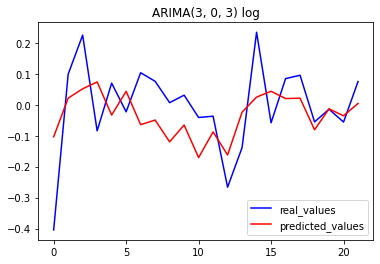

In [35]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    arima = ARIMA(y_log_train, order=(3, 0, 3)).fit()
    display(arima.summary())
    preds_base, evals_base = evaluate_arima_model((3, 0, 3), y_log_train, y_log_test, "ARIMA(3, 0, 3) log")
    display(evals_base)
    fig, ax = plt.subplots()
    ax.plot(np.arange(len(y_log_test)), y_log_test, label='real_values', color='b')
    ax.plot(np.arange(len(y_log_test)), preds_base, label='predicted_values', color = 'r')
    legend = ax.legend()
    ax.set_title("ARIMA(3, 0, 3) log")

# What about residuals?

Text(0.5, 1.0, 'ACF for ARIMA(3, 0, 3) resids_train**2')

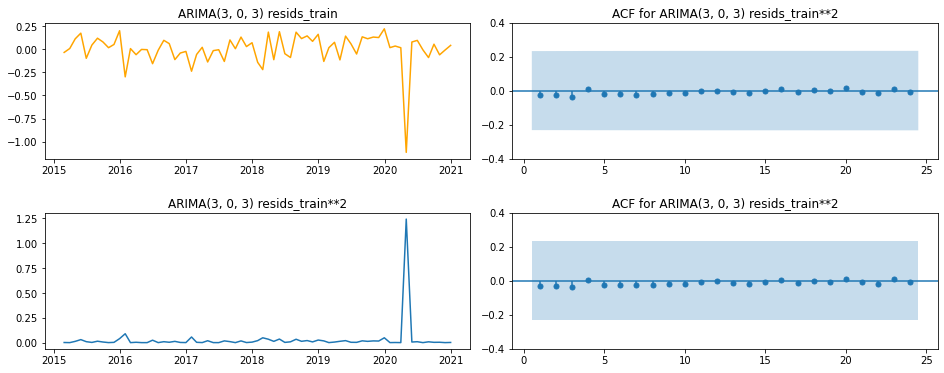

In [36]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    arima = ARIMA(y_log_train, order=(3, 0, 3)).fit()
    preds_303_train = arima.predict()


fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(16, 6))
plt.subplots_adjust(wspace=0.1, hspace=0.4)
ax[0][0].plot(y_log_train-preds_303_train, color='orange')
ax[0][0].set_title("ARIMA(3, 0, 3) resids_train")

ax[1][0].plot((y_log_train-preds_303_train)**2)
ax[1][0].set_title("ARIMA(3, 0, 3) resids_train**2")

plot_acf((y_log_train-preds_303_train)**2, ax=ax[0][1], lags=np.arange(1, 25))
ax[0][1].set_ylim(-.4, .4)
ax[0][1].set_title("ACF for ARIMA(3, 0, 3) resids_train**2")

plot_pacf((y_log_train-preds_303_train)**2, ax=ax[1][1], lags=np.arange(1, 25), method='ywm')
ax[1][1].set_ylim(-.4, .4)
ax[1][1].set_title("ACF for ARIMA(3, 0, 3) resids_train**2")